# Modeling the long term outcome of stroke patients

## Table of contents

+ [Notebook setup](#notebook-setup)
+ [Preprocessing]((#preprocessing))
    + [The target](#the-target)
    + [The features](#the-features)
    + [Splitting the dataset](#splitting-the-dataset)
    + [Imbalances](#imbalances)
    + [Preparation of Data Scaling and Category Encoding](#preparation-of-data-scaling-and-category-encoding)
+ [Supervised Learning](#supervised-learning)
    + [The metric](#the-metric)
    + [Dummy Classifier](#dummy-classifier)
    + [Logistic Regression](#logistic-regression)
        + Standard Scaler
        + MinMaxScaler
    + [Decision Tree](#decision-tree)
    + [Random Forest](#random-forest)
    + [Extra Tree](#random-forest)
    + [XGBoost](#xgboost)
    + [Support Vector Machines](#support-vector-machines)
+ [Unsupervised Learning](#unsupervised-learning)
    + [Principal Component Analysis](#principal-component-analysis)
    + [KMeans](#kmeans)
    + [MiniBatch KMeans](#minibatchkmeans)
    + [Agglomerative Clustering](#agglomerative-clustering)
    + [DBSCAN](#dbscan)
+ [Semi-supervised Learning](#semi-supervised-learning)
    + [Gaussian Mixture](#gaussian-mixture)

-----



## Notebook setup

In [1]:
# general
import pandas as pd
import numpy as np
from functions import helper

# plot libarys
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

# Model preparation
#import imblearn
from imblearn.under_sampling import RandomUnderSampler, EditedNearestNeighbours
from imblearn.over_sampling import RandomOverSampler, SMOTE
from imblearn.combine import SMOTEENN
from imblearn.pipeline import make_pipeline
from sklearn.model_selection import train_test_split, RandomizedSearchCV, GridSearchCV, cross_validate
from sklearn.preprocessing import OneHotEncoder, MinMaxScaler, StandardScaler, LabelEncoder, OrdinalEncoder
from sklearn.compose import ColumnTransformer, make_column_selector

from sklearn.dummy import DummyClassifier
 

# Classifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier, export_graphviz  
from sklearn.neighbors import KNeighborsClassifier, NearestNeighbors
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier, ExtraTreesClassifier
from xgboost import XGBClassifier

## Cluster and Dimension Reduction
from kneed import KneeLocator
from sklearn.cluster import DBSCAN, MiniBatchKMeans, KMeans, AgglomerativeClustering
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.mixture import GaussianMixture
from scipy.cluster import hierarchy

from sklearn.pipeline import Pipeline

# Model Metrics
from sklearn.metrics import precision_score, recall_score, roc_auc_score, roc_curve, confusion_matrix, classification_report, plot_confusion_matrix
from sklearn.metrics import f1_score, make_scorer, adjusted_rand_score, precision_recall_curve, rand_score, accuracy_score
from scipy.stats import multivariate_normal, sem

# for merging the dataframes
import os, glob
import json

# further libarys
import itertools
from sklearn.tree import export_graphviz
from collections import Counter

%matplotlib inline

In [2]:
# Get the data
df = pd.read_csv('data/IST_corrected_clean.csv',  index_col= [0])

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 18779 entries, 0 to 19434
Columns: 113 entries, HOSPNUM to RDISCH14
dtypes: float64(16), int64(29), object(68)
memory usage: 16.3+ MB


In [4]:
# Reset the index
df.index = pd.RangeIndex(len(df.index))

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18779 entries, 0 to 18778
Columns: 113 entries, HOSPNUM to RDISCH14
dtypes: float64(16), int64(29), object(68)
memory usage: 16.2+ MB


-----
## Preprocessing
### The target

Two weeks after the intial stroke, we want to predict the health condition of patients six prior the first stroke. Thus, we will exclude patients that have died within 14 days after their stroke.

In [6]:
df = df[df['DDEAD'] != 'Y']

A little recap: there are three variables for the longterm outcome. We are going to use "OCCODE" over "FRECOVER" and "FDENNIS" as this variable includes more information and is a little more conservative (e.g. patients who are labeled as recovered in "FRECOVER" and as dependent in "OCCODE"). See notebook XXX for more info.

In [7]:
print(f'Patients recovered: {round((df.OCCODE.value_counts()[2] / df.shape[0] * 100),1)} %')
print(f'Patients not recovered: {round((df.OCCODE.value_counts()[1] / df.shape[0] * 100),1)} %')
print(f'Patients dependent: {round((df.OCCODE.value_counts()[0] / df.shape[0] * 100),1)} %')
print(f'Patients deceased: {round((df.OCCODE.value_counts()[3] / df.shape[0] * 100),1)} %')

Patients recovered: 18.9 %
Patients not recovered: 22.3 %
Patients dependent: 46.1 %
Patients deceased: 12.7 %


We aimed to create a model that predicts poor health condition of patients six months after their (initial) stroke. For this we do not distinguish between "not recovered", "dependent" or "dead". Hence, we generated new target column "NOREC" - with 0 for recovered patients and 1 for all other outcomes.

In [8]:
def target(row):
    if row.OCCODE == 'Recovered':
        return 0
    elif row.OCCODE in ['Not recovered', 'Dependent', 'Dead']:
        return 1
    else:
        return np.nan

In [9]:
# Create the new target column
df['NOREC'] = df.apply(lambda row: target(row), axis=1)

In [10]:
df.NOREC.isnull().sum()

0

### The features

For the prediction of the models we implemented the variables for age, sex, blood pressure, atrial fibrillation, possible deficits (e.g. arm/hand deficit, foot/leg deficit and such), indicator for non-cerebral bleeds as well as the indicator for any stroke, both within 14 days. 

Other variables were included in the first runs of the models (such as type of stroke), but were excluded as they did not improve the models and we aimed at building simple models. 

In [11]:
# drop missing values from 'RATRIAL'
df = df.dropna(subset = ['RATRIAL'])

In [12]:
# convert NCB14 and STRK14 into categoricals
df['NCB14'] = df.NCB14.astype('object')
df['STRK14'] = df.STRK14.astype('object')

# Select features
features = ['SEX', 'AGE', 'RSBP', 'RDEF1', 'RDEF2', 'RDEF3', 'RDEF4', 'RDEF5', 'RDEF6', 'RDEF7', 'NCB14', 'STRK14', 'RATRIAL']
X = df[features]

# Select target NOREC
y = df.NOREC

There are no "U" (unknowns) in the selected features. If there had been, we would have drop those instances as they would not have provided any useful information.

In [13]:
object_col = list(X.select_dtypes(include='object').columns)

# Iterate over object columns
for column in object_col:
    columnSeriesObj = X[column]
    print()
    print('Colunm Name: ', column)
    print('Describe: ', columnSeriesObj.describe())
    if columnSeriesObj.nunique() <= 6:
        print('Unique values: ', columnSeriesObj.unique())
        print('Value counts: ', columnSeriesObj.value_counts()) # Check Categories (particularly 'U' = 'Unknown')


Colunm Name:  SEX
Describe:  count     15941
unique        2
top           M
freq       8605
Name: SEX, dtype: object
Unique values:  ['F' 'M']
Value counts:  M    8605
F    7336
Name: SEX, dtype: int64

Colunm Name:  RDEF1
Describe:  count     15941
unique        3
top           Y
freq      11446
Name: RDEF1, dtype: object
Unique values:  ['Y' 'N' 'C']
Value counts:  Y    11446
N     4334
C      161
Name: RDEF1, dtype: int64

Colunm Name:  RDEF2
Describe:  count     15941
unique        3
top           Y
freq      13607
Name: RDEF2, dtype: object
Unique values:  ['Y' 'N' 'C']
Value counts:  Y    13607
N     2247
C       87
Name: RDEF2, dtype: int64

Colunm Name:  RDEF3
Describe:  count     15941
unique        3
top           Y
freq      11907
Name: RDEF3, dtype: object
Unique values:  ['Y' 'N' 'C']
Value counts:  Y    11907
N     3843
C      191
Name: RDEF3, dtype: int64

Colunm Name:  RDEF4
Describe:  count     15941
unique        3
top           N
freq       8829
Name: RDEF4, dtype:

### Splitting the dataset

We split the dataset into a training and a test set. The training set was made up of 70% of the entire dataset. The testset was implemented to test the trained models for performance.

In [14]:
# Split the data in test and training set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [15]:
#convert all 'objects' into 'categories'
X_train = pd.concat([
        X_train.select_dtypes([], ['object']),
        X_train.select_dtypes(['object']).apply(pd.Series.astype, dtype='category')
        ], axis=1).reindex(X_train.columns, axis=1)

In [16]:
#convert all 'objects' into 'categories' 
X_test = pd.concat([
        X_test.select_dtypes([], ['object']),
        X_test.select_dtypes(['object']).apply(pd.Series.astype, dtype='category')
        ], axis=1).reindex(X_test.columns, axis=1)

### Imbalances 

The dataset is imbalanced. We balance this out with a combination of undersampling and oversampling.

In [17]:
print(f'                     Patients recovered: {round((y_train.value_counts()[1] / y_train.shape[0] * 100),1)} %')
print(f'Patients not recovered, dependent, dead: {round((y_train.value_counts()[0] / y_train.shape[0] * 100),1)} %')

                     Patients recovered: 81.2 %
Patients not recovered, dependent, dead: 18.8 %


The ratio of the groups is about 1:4. We will implement SMOTEENN. The SMOTE-part of this function will oversample the minority group and the ENN-part (Edited Nearest Neighbours) will provide some clean up by undersampling the majority group. These functions will be implemented before each training each model. At each singular point we will feed the transformed data into SMOTEENN. This how this will look like:

In [18]:
sme = SMOTEENN(random_state= 42)

### Preparation of Data Scaling and Category Encoding
Some models need scaling of numerical features and encoding of categorical features. The sklearn preprocessors are instantiated here and used where necessary in the data transformation step of each model.

In [19]:
# encoder for categories
onehot = OneHotEncoder(drop="first")

# scalers for numerical features
mms = MinMaxScaler()
ss = StandardScaler()

# Prepare list of numerical and categorical columns
num_cols = make_column_selector(dtype_include=np.number)
cat_cols = make_column_selector(dtype_include='category')

-----
## Supervised Learning
### The metric

We need to define a suitable metric for evaluating model performance. We want to be sure that we predict if the participants had a poor longterm outcome (i.e. "not recovered", "dependent" or "dead"), which is `NOREC = 1`, correctly. We want to have a few false negatives as possible. Hence, our evaluation metric is recall.

### Dummy classifier

The baseline model was generated by implementing the dummy classifier from sklearn. We get a recall of 81% with an accuracy of 50%, which needs to be beaten by the final model.

In [23]:
# Define transformer
transformer = ColumnTransformer([
    ("scale", ss, num_cols),
    ("encode", onehot, cat_cols),
])

# Transform
X_train_trans = transformer.fit_transform(X_train)
X_test_trans = transformer.transform(X_test)

# Over/undersampling
X_train_trans_r, y_train_r = sme.fit_resample(X_train_trans, y_train)

In [21]:
clf_dummy = DummyClassifier(strategy='uniform', random_state=42)

In [22]:
repeats = range(5)
dummy_train = []
for r in repeats:
	# evaluate using a given number of repeats
	scores_train = helper.evaluate_model(clf_dummy, X_train_trans_r, y_train_r)
	# summarize
	print('>%d mean=%.4f se=%.3f' % (r, np.mean(scores_train), sem(scores_train)))
	# store
	dummy_train.append(scores_train)

>0 mean=0.5057 se=0.000
>1 mean=0.5057 se=0.000
>2 mean=0.5057 se=0.000
>3 mean=0.5057 se=0.000
>4 mean=0.5057 se=0.000


              precision    recall  f1-score   support

           0       0.19      0.50      0.28       921
           1       0.81      0.50      0.62      3862

    accuracy                           0.50      4783
   macro avg       0.50      0.50      0.45      4783
weighted avg       0.69      0.50      0.55      4783

[[ 465  456]
 [1922 1940]]


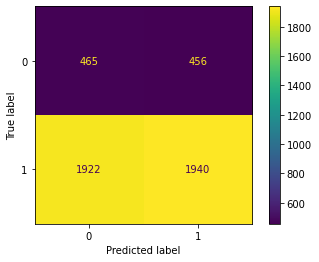

In [23]:
m_dummy = clf_dummy.fit(X_train_trans_r, y_train_r)
y_pred = m_dummy.predict(X_test_trans)

print(classification_report(y_test,y_pred))
print(confusion_matrix(y_test,y_pred))
plot_confusion_matrix(m_dummy, X_test_trans, y_test)

### Logistic Regression
#### Standard Scaler
For Logistic Regression we need to scale our data and encode categorical data. As the categories are not ordinal, we use one-hot-encoding.
First we will use logistic regression with data that was scaled with Standard Scaler.


In [24]:
# Define transformer
transformer = ColumnTransformer([
    ("scale", ss, num_cols),
    ("encode", onehot, cat_cols),
])

# Transform
X_train_trans = transformer.fit_transform(X_train)
X_test_trans = transformer.transform(X_test)

# Over/undersampling
X_train_trans_r, y_train_r = sme.fit_resample(X_train_trans, y_train)

In [79]:
logreg_ss = LogisticRegression(max_iter=400, random_state= 42)

In [80]:
repeats = range(5)
logreg_ss_train = []
for r in repeats:
	# evaluate using a given number of repeats
	scores_train = helper.evaluate_model(logreg_ss, X_train_trans_r, y_train_r)
	# summarize
	print('>%d mean=%.4f se=%.3f' % (r, np.mean(scores_train), sem(scores_train)))
	# store
	logreg_ss_train.append(scores_train)

AttributeError: module 'functions.helper' has no attribute 'evaluate_model'

In [78]:
m_logreg_ss, y_pred = helper.pred_model(logreg_ss, X_train_trans, y_train)

NameError: name 'logreg_ss' is not defined

The recall is 57% and accuracy is 61%. By adjusting the threshold we can achieve a recall of 94% and an accuracy of 80%.

In [34]:
# Classification report
y_probs = m_logreg_ss.predict_proba(X_test_trans)[:, 1]

y_pred = y_probs > 0.1
print(f"--- CLASSIFICATION REPORT {'-'*10}")
print(classification_report(y_test,y_pred))
print(f"--- CONFUSION MATRIX {'-'*10}")
print(confusion_matrix(y_test,y_pred))

--- CLASSIFICATION REPORT ----------
              precision    recall  f1-score   support

           0       0.46      0.20      0.27       921
           1       0.83      0.94      0.88      3862

    accuracy                           0.80      4783
   macro avg       0.64      0.57      0.58      4783
weighted avg       0.76      0.80      0.77      4783

--- CONFUSION MATRIX ----------
[[ 181  740]
 [ 215 3647]]


In [ ]:
#### MinMaxScaler

Let's see if we achieve other - even better - results with the MinMaxScaler.

In [20]:
# Define transformer
transformer = ColumnTransformer([
    ("scale", mms, num_cols),
    ("encode", onehot, cat_cols),
])

# Transform
X_train_trans = transformer.fit_transform(X_train)
X_test_trans = transformer.transform(X_test)


# Over/undersampling
X_train_trans_r, y_train_r = sme.fit_resample(X_train_trans, y_train)

In [21]:
# Calculate the LogisticRegression
logreg = LogisticRegression(max_iter=400, random_state= 42)
#logreg_pipe = (sme, logreg)

In [39]:
scores_train = six.evaluate_model(logreg, X_train_trans_r, y_train_r)
print(f'Average Score: {round(np.mean(scores_train),3)} with an Standard Error of {round(sem(scores_train), 4)}')

Average Score: 0.755 with an Standard Erroe of 0.0034


              precision    recall  f1-score   support

           0       0.30      0.76      0.43       921
           1       0.91      0.58      0.71      3862

    accuracy                           0.61      4783
   macro avg       0.60      0.67      0.57      4783
weighted avg       0.79      0.61      0.66      4783

[[ 696  225]
 [1617 2245]]


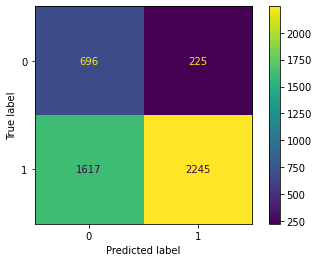

In [22]:
m_logreg_mm, y_pred = helper.pred_model(logreg, X_train_trans_r, X_test_trans, y_train_r, y_test)

MinMax Scaler performed slightly better than the Standard Scaler. The recall is 58% and accuracy is 61%. Again, by adjusting the threshold we can achieve a recall of 5% and accuracy of 80%

In [23]:
# Classification report
y_probs = m_logreg_mm.predict_proba(X_test_trans)[:, 1]

y_pred = y_probs > 0.1
print(f"--- CLASSIFICATION REPORT {'-'*10}")
print(classification_report(y_test,y_pred))
print(f"--- CONFUSION MATRIX {'-'*10}")
print(confusion_matrix(y_test,y_pred))

--- CLASSIFICATION REPORT ----------
              precision    recall  f1-score   support

           0       0.46      0.20      0.27       921
           1       0.83      0.95      0.88      3862

    accuracy                           0.80      4783
   macro avg       0.65      0.57      0.58      4783
weighted avg       0.76      0.80      0.77      4783

--- CONFUSION MATRIX ----------
[[ 180  741]
 [ 209 3653]]


### Decision Tree
For Decision Trees numerical data doesn't need to be scaled. Categorical data needs to be encoded. As One-Hot-Encoding leads to sparse data and decreases the performance of decision trees, we encode the categories numerically.

In [20]:
# Encode categorical features (with more than two classes)
X_train_trans = X_train.copy()
X_test_trans = X_test.copy()
for cat in ['SEX', 'RDEF1', 'RDEF2', 'RDEF3', 'RDEF4', 'RDEF5', 'RDEF6', 'RDEF7', 'RATRIAL', 'NCB14', 'STRK14']:
    X_train_trans[[cat]] = X_train_trans[cat].cat.codes
    X_test_trans[[cat]] = X_test_trans[cat].cat.codes

In [21]:
dtree = DecisionTreeClassifier(random_state=42)

In [22]:
# Define Classifier
dtree_pipe = make_pipeline(sme, dtree)

In [23]:
scores_dtree = helper.evaluate_model(dtree_pipe, X_train_trans, y_train)
print(f'Average Score: {round(np.mean(scores_dtree),3)} with an Standard Error of {round(sem(scores_dtree), 4)}')

Average Score: 0.684 with an Standard Error of 0.0028


              precision    recall  f1-score   support

           0       0.28      0.51      0.37       921
           1       0.86      0.69      0.77      3862

    accuracy                           0.66      4783
   macro avg       0.57      0.60      0.57      4783
weighted avg       0.75      0.66      0.69      4783

[[ 473  448]
 [1189 2673]]


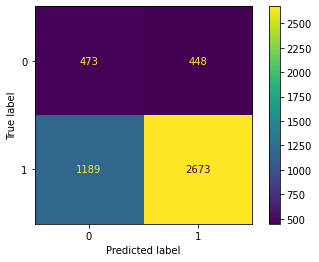

In [30]:
m_dtree, y_pred = helper.pred_model(dtree_pipe, X_train_trans, X_test_trans, y_train, y_test)

The decision tree model has a recall of 51% and an accuracy of 66%.

#### With imbalanced data

Here we try using the imbalanced data and let the function of decisiontree() balance the data by implementing `class_weight`, instead of SMOTEENN.

In [21]:
dtree_w = DecisionTreeClassifier(random_state=42, class_weight= 'balanced')

In [25]:
scores_dtree_w = helper.evaluate_model(dtree_w, X_train_trans, y_train)
print(f'Average Score: {round(np.mean(scores_dtree_w),3)} with an Standard Error of {round(sem(scores_dtree_w), 4)}')

Average Score: 0.782 with an Standard Error of 0.0019


              precision    recall  f1-score   support

           0       0.24      0.28      0.26       921
           1       0.82      0.79      0.81      3862

    accuracy                           0.69      4783
   macro avg       0.53      0.53      0.53      4783
weighted avg       0.71      0.69      0.70      4783

[[ 255  666]
 [ 805 3057]]


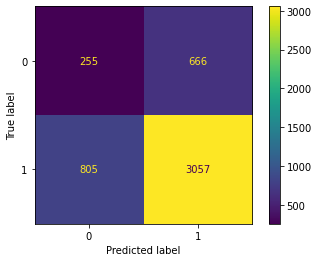

In [26]:
m_dtree_w, y_pred = helper.pred_model(dtree_w, X_train_trans, X_test_trans, y_train, y_test)

By adjusting the class weigths, the decision tree model has now a recall of 79% and an accuracy of 69%. Let's see if we can find some better model parameters with a randomized grid search.

#### Randomized Grid Search

In [22]:
params_grid = {
    "criterion": ["gini", "entropy"],
    "splitter": ["best", "random"],
    "max_features": ["auto", "sqrt", "log2"], 
    "max_depth": np.arange(10, 50, 2),
    "min_samples_leaf": np.arange(1, 30, 2),
    "class_weight": ['balanced']
}
rs_dtree_w = helper.rs_model(dtree_w, X_train_trans, y_train, params_grid)

res=auto, min_samples_leaf=25, splitter=best; total time=   0.0s
[CV 13/15] END class_weight=balanced, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=25, splitter=best; total time=   0.0s
[CV 14/15] END class_weight=balanced, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=25, splitter=best; total time=   0.0s
[CV 15/15] END class_weight=balanced, criterion=entropy, max_depth=40, max_features=auto, min_samples_leaf=25, splitter=best; total time=   0.0s
[CV 1/15] END class_weight=balanced, criterion=entropy, max_depth=46, max_features=log2, min_samples_leaf=27, splitter=random; total time=   0.0s
[CV 2/15] END class_weight=balanced, criterion=entropy, max_depth=46, max_features=log2, min_samples_leaf=27, splitter=random; total time=   0.0s
[CV 3/15] END class_weight=balanced, criterion=entropy, max_depth=46, max_features=log2, min_samples_leaf=27, splitter=random; total time=   0.0s
[CV 4/15] END class_weight=balanced, criterion=entropy, max_de

The best decision tree model in our randomized grid search has the following hyperparameters: 
+ 'splitter': 'best'
+ 'min_samples_leaf': 3, 
+ 'max_features': 'sqrt', 
+ 'max_depth': 38, 
+ 'criterion': 'entropy', 
+ 'class_weight': 'balanced'.

Let's train the model with these settings and check the results:

In [23]:
dtree_best = DecisionTreeClassifier(splitter= 'best', min_samples_leaf= 3, max_features= 'sqrt', max_depth= 38, criterion= 'entropy', class_weight= 'balanced')

              precision    recall  f1-score   support

           0       0.27      0.58      0.37       921
           1       0.86      0.62      0.72      3862

    accuracy                           0.61      4783
   macro avg       0.56      0.60      0.54      4783
weighted avg       0.75      0.61      0.65      4783

[[ 535  386]
 [1469 2393]]


DecisionTreeClassifier(class_weight='balanced', criterion='entropy',
                       max_depth=38, max_features='sqrt', min_samples_leaf=3)

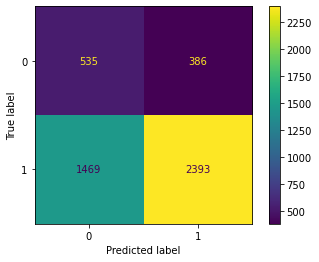

In [24]:
helper.pred_model(dtree_best, X_train_trans, X_test_trans, y_train, y_test)

Recall and accuracy have not increased. So we will keep the other model.

### Random Forest
For Random Forests we use the same data scaling and encoding as for decision trees.

In [25]:
# Encode categorical features
X_train_trans = X_train.copy()
X_test_trans = X_test.copy()
for cat in ['SEX', 'RDEF1', 'RDEF2', 'RDEF3', 'RDEF4', 'RDEF5', 'RDEF6', 'RDEF7', 'RATRIAL', 'NCB14', 'STRK14']:
    X_train_trans[[cat]] = X_train_trans[cat].cat.codes
    X_test_trans[[cat]] = X_test_trans[cat].cat.codes

In [26]:
rf = RandomForestClassifier(random_state = 42)

In [27]:
# Define Classifier
rf_pipe = make_pipeline(sme, rf)

In [28]:
scores_rf = six.evaluate_model(rf_pipe, X_train_trans, y_train)
print(f'Average Score: {round(np.mean(scores_rf),3)} with an Standard Error of {round(sem(scores_rf), 4)}')

Average Score: 0.697 with an Standard Error of 0.0028


              precision    recall  f1-score   support

           0       0.31      0.55      0.39       921
           1       0.87      0.71      0.78      3862

    accuracy                           0.68      4783
   macro avg       0.59      0.63      0.59      4783
weighted avg       0.76      0.68      0.71      4783

[[ 505  416]
 [1131 2731]]


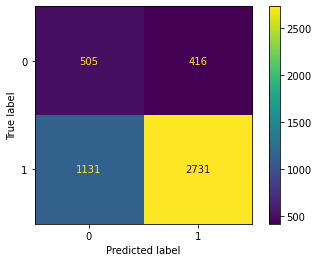

In [29]:
m_rf, y_pred = helper.pred_model(rf_pipe, X_train_trans, X_test_trans, y_train, y_test)

Recall of the Random Forest is 55% and accuracy is 68%.


#### With imbalanced 

As conducted with decisiontree, we ill now try using the imbalanced data and let randomforest balance the weights of the groups.

In [26]:
rf_w = RandomForestClassifier(random_state = 42, class_weight= 'balanced')

Average Score: 0.888 with an Standard Error of 0.0014
              precision    recall  f1-score   support

           0       0.29      0.19      0.23       921
           1       0.82      0.89      0.86      3862

    accuracy                           0.76      4783
   macro avg       0.56      0.54      0.54      4783
weighted avg       0.72      0.76      0.73      4783

[[ 172  749]
 [ 417 3445]]


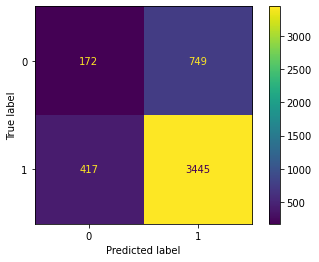

In [42]:
scores_rf_w = helper.evaluate_model(rf_w, X_train_trans, y_train)
print(f'Average Score: {round(np.mean(scores_rf_w),3)} with an Standard Error of {round(sem(scores_rf_w), 4)}')

m_rf_w, y_pred = helper.pred_model(rf_w, X_train_trans, X_test_trans, y_train, y_test)

Recall has increased to 89% and accuracy is 76%. Let's concuct a randomized grid search to tune the hyperparameters.

#### Randomized Grid Search

In [27]:
params_grid = {
    "criterion": ["gini", "entropy"],
    "max_features": ["auto", "sqrt", "log2"], 
    "max_depth": np.arange(10, 50, 2),
    "min_samples_leaf": np.arange(1, 30, 2),
    "class_weight": ['balanced']
}
six.run_rand_grid_search(rf_w, X_train_trans, y_train, params_grid)

Fitting 15 folds for each of 10 candidates, totalling 150 fits
[CV 1/15] END class_weight=balanced, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=3; total time=   1.1s
[CV 2/15] END class_weight=balanced, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=3; total time=   1.1s
[CV 3/15] END class_weight=balanced, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=3; total time=   1.1s
[CV 4/15] END class_weight=balanced, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=3; total time=   1.2s
[CV 5/15] END class_weight=balanced, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=3; total time=   1.0s
[CV 6/15] END class_weight=balanced, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=3; total time=   1.0s
[CV 7/15] END class_weight=balanced, criterion=entropy, max_depth=20, max_features=auto, min_samples_leaf=3; total time=   1.0s
[CV 8/15] END class_weight=balanced, crit

RandomizedSearchCV(cv=RepeatedStratifiedKFold(n_repeats=3, n_splits=5, random_state=42),
                   estimator=RandomForestClassifier(class_weight='balanced',
                                                    random_state=42),
                   param_distributions={'class_weight': ['balanced'],
                                        'criterion': ['gini', 'entropy'],
                                        'max_depth': array([10, 12, 14, 16, 18, 20, 22, 24, 26, 28, 30, 32, 34, 36, 38, 40, 42,
       44, 46, 48]),
                                        'max_features': ['auto', 'sqrt',
                                                         'log2'],
                                        'min_samples_leaf': array([ 1,  3,  5,  7,  9, 11, 13, 15, 17, 19, 21, 23, 25, 27, 29])},
                   random_state=42, scoring='recall', verbose=5)

+ Best model: {'min_samples_leaf': 1, 'max_features': 'sqrt', 'max_depth': 18, 'criterion': 'entropy', 'class_weight': 'balanced'}
+ Best cross-validated Score: 0.7810305674300905


In [29]:
rf_best = RandomForestClassifier(min_samples_leaf= 1, max_features= 'sqrt', max_depth = 18, criterion = 'entropy', class_weight= 'balanced')

array([0.74613687, 0.73951435, 0.79249448, 0.78256071, 0.74613687,
       0.78366446, 0.78895028, 0.77458564, 0.78232044, 0.82209945,
       0.73730684, 0.77262693, 0.79801325, 0.78476821, 0.79359823,
       0.77041943, 0.75690608, 0.78674033, 0.80994475, 0.76132597,
       0.76600442, 0.77483444, 0.80684327, 0.79580574, 0.7803532 ,
       0.74724062, 0.79668508, 0.74475138, 0.78121547, 0.76685083,
       0.78697572, 0.78697572, 0.79470199, 0.77041943, 0.77704194,
       0.77373068, 0.78342541, 0.79005525, 0.75469613, 0.78232044,
       0.76821192, 0.78366446, 0.78145695, 0.76490066, 0.7803532 ,
       0.77041943, 0.76132597, 0.7878453 , 0.77348066, 0.8       ])

Average Score: 0.776 with an Standard Error of 0.0022
              precision    recall  f1-score   support

           0       0.31      0.44      0.36       921
           1       0.85      0.76      0.81      3862

    accuracy                           0.70      4783
   macro avg       0.58      0.60      0.58      4783
weighted avg       0.75      0.70      0.72      4783

[[ 404  517]
 [ 911 2951]]


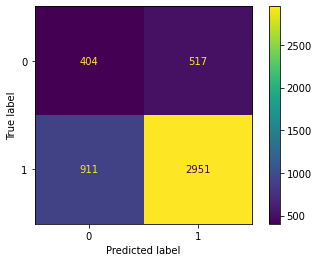

In [30]:
scores_rf_best = six.evaluate_model(rf_best, X_train_trans, y_train)
print(f'Average Score: {round(np.mean(scores_rf_best),3)} with an Standard Error of {round(sem(scores_rf_best), 4)}')

m_rf_best = helper.pred_model(rf_best, X_train_trans, X_test_trans, y_train, y_test)

+ 0.7
+ 0: .31 .44
+ 1: .85 .76

### Extra Tree

Still working with trees, we keep the same data transformation:

In [36]:
# Encode categorical features (with more than two classes)
X_train_trans = X_train.copy()
X_test_trans = X_test.copy()
for cat in ['SEX', 'RDEF1', 'RDEF2', 'RDEF3', 'RDEF4', 'RDEF5', 'RDEF6', 'RDEF7', 'RATRIAL', 'NCB14', 'STRK14']:
    X_train_trans[[cat]] = X_train_trans[cat].cat.codes
    X_test_trans[[cat]] = X_test_trans[cat].cat.codes

In [37]:
etree = ExtraTreesClassifier(random_state=42)
etree_pipe = make_pipeline(sme, etree)

In [38]:
scores_etree = helper.evaluate_model(etree_pipe, X_train_trans, y_train)

In [39]:
print(f'Average Score: {round(np.mean(scores_etree),3)} with an Standard Error of {round(sem(scores_etree), 4)}')

Average Score: 0.715 with an Standard Error of 0.0028


              precision    recall  f1-score   support

           0       0.31      0.52      0.39       921
           1       0.86      0.72      0.78      3862

    accuracy                           0.68      4783
   macro avg       0.58      0.62      0.59      4783
weighted avg       0.76      0.68      0.71      4783

[[ 480  441]
 [1086 2776]]


Pipeline(steps=[('smoteenn', SMOTEENN(random_state=42)),
                ('extratreesclassifier',
                 ExtraTreesClassifier(random_state=42))])

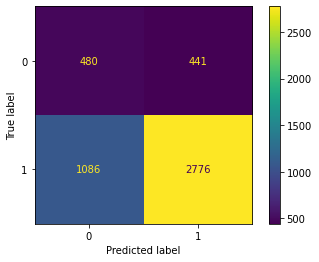

In [40]:
helper.pred_model(etree_pipe, X_train_trans, X_test_trans, y_train, y_test)

The Extra Tree model achieves a recall of 52% and an accuracy of 68%.

#### With imbalanced 

As conducted with Decision Tree and Extra Tree, we will now try using the imbalanced data and let randomforest balance the weights of the groups.

In [ ]:
etree_w = ExtraTreesClassifier(random_state=42, class_weight = 'balanced')
etree_pipe_w = make_pipeline(sme, etree_w)

In [ ]:
scores_etree_w = helper.evaluate_model(etree_pipe_w, X_train_trans, y_train)
print(f'Average Score: {round(np.mean(scores_etree_w),3)} with an Standard Error of {round(sem(scores_etree_w), 4)}')
helper.pred_model(etree_pipe_w, X_train_trans, X_test_trans, y_train, y_test)

### XGBoost
As XGBoost is working with trees, we use the same data transformation where we encode categories numerically.

In [41]:
# Encode categorical features (with more than two classes)
X_train_trans = X_train.copy()
X_test_trans = X_test.copy()
for cat in ['SEX', 'RDEF1', 'RDEF2', 'RDEF3', 'RDEF4', 'RDEF5', 'RDEF6', 'RDEF7', 'RATRIAL', 'NCB14', 'STRK14']:
    X_train_trans[[cat]] = X_train_trans[cat].cat.codes
    X_test_trans[[cat]] = X_test_trans[cat].cat.codes

In [42]:
# Define Classifier
xgb = XGBClassifier(random_state = 42)
xgb_pipe = make_pipeline(sme, xgb)

In [43]:
scores_xgb = helper.evaluate_model(xgb_pipe, X_train_trans, y_train)

In [44]:
print(f'Average Score: {round(np.mean(scores_xgb),3)} with an Standard Error of {round(sem(scores_xgb), 4)}')

Average Score: 0.659 with an Standard Error of 0.0028


/Users/Nicole/Documents/Data_Science/neuefische/projects/Capstone/stroke/Stroke-Outcome/.venv/lib/python3.8/site-packages/xgboost/sklearn.py:1146: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
[14:39:18] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1095: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
              precision    recall  f1-score   support

           0       0.30      0.59      0.39       921
           1       0.87      0.66      0.75      3862

    accuracy         

Pipeline(steps=[('smoteenn', SMOTEENN(random_state=42)),
                ('xgbclassifier',
                 XGBClassifier(base_score=0.5, booster='gbtree',
                               colsample_bylevel=1, colsample_bynode=1,
                               colsample_bytree=1, gamma=0, gpu_id=-1,
                               importance_type='gain',
                               interaction_constraints='',
                               learning_rate=0.300000012, max_delta_step=0,
                               max_depth=6, min_child_weight=1, missing=nan,
                               monotone_constraints='()', n_estimators=100,
                               n_jobs=4, num_parallel_tree=1, random_state=42,
                               reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
                               subsample=1, tree_method='exact',
                               validate_parameters=1, verbosity=None))])

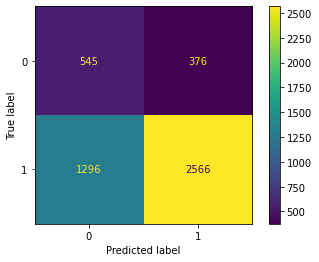

In [45]:
helper.pred_model(xgb_pipe, X_train_trans, X_test_trans, y_train, y_test)

With XGBoost we got a model that has a recall of 66% and an accuracy of 65%.

### Support Vector Machines


In [46]:
# Encode categorical features 
X_train_trans = X_train.copy()
X_test_trans = X_test.copy()
for cat in ['SEX', 'RDEF1', 'RDEF2', 'RDEF3', 'RDEF4', 'RDEF5', 'RDEF6', 'RDEF7', 'RATRIAL', 'NCB14', 'STRK14']:
    X_train_trans[[cat]] = X_train_trans[cat].cat.codes
    X_test_trans[[cat]] = X_test_trans[cat].cat.codes

In [51]:
# Define Classifier
svc = SVC(random_state = 42)
svc_pipe = make_pipeline(sme, svc)

In [52]:
scores_svc = six.evaluate_model(svc_pipe, X_train_trans, y_train)

In [53]:
print(f'Average Score: {round(np.mean(scores_svc),3)} with an Standard Error of {round(sem(scores_svc), 4)}')

Average Score: 0.35 with an Standard Error of 0.0041


              precision    recall  f1-score   support

           0       0.23      0.78      0.36       921
           1       0.88      0.38      0.53      3862

    accuracy                           0.46      4783
   macro avg       0.56      0.58      0.44      4783
weighted avg       0.75      0.46      0.50      4783

[[ 718  203]
 [2387 1475]]


Pipeline(steps=[('smoteenn', SMOTEENN(random_state=42)),
                ('svc', SVC(random_state=42))])

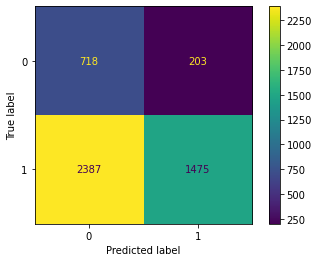

In [54]:
helper.pred_model(svc_pipe, X_train_trans, X_test_trans, y_train, y_test)

With the Support Vector Machines we got a model that had 38% recall and 46% accuracy.

## Unsupervised Learning

### The metric
Adjusted rand index (ARI) uses true cluster assignments to measure the similarity between true and predicted labels. The ARI output values range between -1 and 1. A score close to 0.0 indicates random assignments, and a score close to 1 indicates perfectly labeled clusters.

### Principal Component Analysis
Let's have a closer look at the data and how it is distributed. By implementing PCA we reduce the dimensions of the data and are able to plot the datapoints in 2D and 3D. 

In [24]:
# Define transformer
transformer = ColumnTransformer([
    ("scale", mms, num_cols),
    ("encode", onehot, cat_cols),
])

# Transform
X_train_trans = transformer.fit_transform(X_train)
X_test_trans = transformer.transform(X_test)

In [26]:
pca_ = PCA(random_state=42)
X_train_pca = pca_.fit_transform(X_train_trans)

We plotted the three first components of the PCA (of the imbalanced - original data) and we can see that we cannot distinguish between the two groups (yellow: not recovered, dependent, dead and blue: recovered).

In [27]:
labels = {
    str(i): f"PC {i+1} ({var:.1f}%)"
    for i, var in enumerate(pca_.explained_variance_ratio_ * 100)
}

fig = px.scatter_matrix(
    X_train_pca,
    labels=labels,
    dimensions=range(4),
    color=y_train
)
fig.update_traces(diagonal_visible=False)
fig.show()

Let's have a look at the 3D plot of the components.

In [28]:
pca_3 = PCA(random_state=42, n_components = 3)
X_train_pca = pca_3.fit_transform(X_train_trans_r)

In [29]:
total_var = pca_3.explained_variance_ratio_.sum() * 100

fig = px.scatter_3d(
    X_train_pca, x=0, y=1, z=2, color=y_train_r,
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'}
)
fig.show()

In a 3D plot we are able to rotate the cloud of points and still see that it is really hard to differentiate between the yellow and blue dots. It is not very surpring, the three Principal Components explain only a bit mire than half of the variance of the data.

By plotting the loadings of single variables we get an idea which variables contribute to the variation of the dataset and how the variables correlate with each other. Lines that a short have less impact on the variation than longer lines. Lines that point in the same direction and are close to each other correlate positively, lines that are going into opposite directions correlate negatively with each other. 

So "AGE", "RDEF1", "RSBP" and "SEX" probably can be excluded from the models as their loadings are fairly small compared to the other variables.
There seems to be a small separation along the first components. The variances of non-recovered patients (yellow) are driven by "NCB14", "RDEF6" and "RDEF4", whereas the the variances of recovered patients (blue) are more driven by the variables "RDEF3", "RDEF5" and "RDEF7".

Though, again, keep in mind that this plot explains just about 40% of the variance we see in the data (PC1 = 23.1%, PC2 = 18.5%)

In [31]:
loadings = pca_.components_.T * np.sqrt(pca_.explained_variance_)

X_train_pca = pca_.fit_transform(X_train_trans)

fig = px.scatter(X_train_pca, x=0, y=1, color=y_train)

for i, feature in enumerate(features):
    fig.add_shape(
        type='line',
        x0=0, y0=0,
        x1=loadings[i, 0],
        y1=loadings[i, 1]
    )
    fig.add_annotation(
        x=loadings[i, 0],
        y=loadings[i, 1],
        ax=0, ay=0,
        xanchor="center",
        yanchor="bottom",
        text=feature,
    )
fig.show()

### Kmeans

In [32]:
# Define transformer
transformer = ColumnTransformer([
    ("scale", mms, num_cols),
    ("encode", onehot, cat_cols),
])

# Transform
X_train_trans = transformer.fit_transform(X_train)
X_test_trans = transformer.transform(X_test)

# Over/undersampling
X_train_trans_r, y_train_r = sme.fit_resample(X_train_trans, y_train)

Let's try another unsupervised algorithm. Here we will implement PCA as a tool for dimension reduction before going ahead with the KMeans model.

In [33]:
# Pipeline for PCA
prepro_pca = PCA(n_components=2, random_state=42)

# Pipeline for clusterer/Kmeans
kmeans = KMeans(max_iter=500, n_clusters=2, n_init=50,random_state=42)

kmeans_pipe = make_pipeline(prepro_pca, kmeans)

In [34]:
kmeans_pipe.fit(X_train_trans_r)

Pipeline(steps=[('pca', PCA(n_components=2, random_state=42)),
                ('kmeans',
                 KMeans(max_iter=500, n_clusters=2, n_init=50,
                        random_state=42))])

3


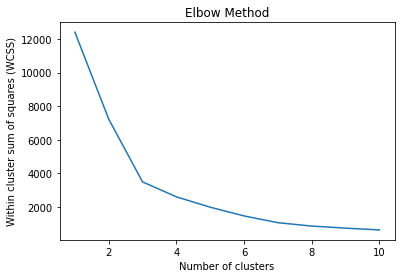

In [35]:
 helper.knee_loc(kmeans_pipe, kmeans_pipe['kmeans'], X_train_trans_r)

In [36]:
kmeans_pipe['kmeans'].n_clusters = 3
kmeans_pipe.fit(X_train_trans_r)

Pipeline(steps=[('pca', PCA(n_components=2, random_state=42)),
                ('kmeans',
                 KMeans(max_iter=500, n_clusters=3, n_init=50,
                        random_state=42))])

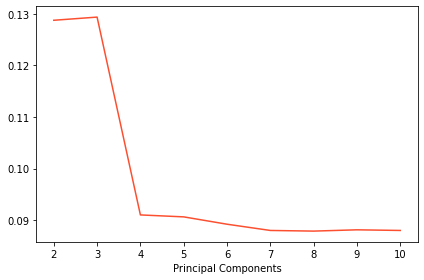

In [37]:
helper.ari_scores(kmeans_pipe, kmeans_pipe['pca'], kmeans_pipe['kmeans'], X_train_trans_r, y_train_r)

In [72]:
kmeans_pipe["pca"].n_components = 3
kmeans_pipe['kmeans'].n_clusters = 3

kmeans_pipe.fit(X_train_trans_r)

Pipeline(steps=[('pca', PCA(n_components=3, random_state=42)),
                ('kmeans',
                 KMeans(max_iter=500, n_clusters=3, n_init=50,
                        random_state=42))])

In [40]:
ari_kmeans = adjusted_rand_score(y_train_r, kmeans_pipe['kmeans'].labels_)
ari_kmeans

0.08797944034083172

The ARI is very low (0.088). So we cannot be sure that what we might get are not just very random clusters. We will try and plot the results anyway:

#### Plotting with PCA

In [54]:
# for plotting only 2 PCs
kmeans_pipe["pca"].n_components = 2
kmeans_pipe.fit(X_train_trans_r)

Pipeline(steps=[('pca', PCA(n_components=2, random_state=42)),
                ('kmeans',
                 KMeans(max_iter=500, n_clusters=3, n_init=50,
                        random_state=42))])

In [55]:
pcadf = pd.DataFrame(kmeans_pipe['pca'].transform(X_train_trans_r),columns=["component_1", "component_2"],)
pcadf["predicted_cluster"] = kmeans_pipe["kmeans"].labels_
pcadf["true_label"] = y_train_r

/Users/Nicole/Documents/Data_Science/neuefische/projects/Capstone/stroke/Stroke-Outcome/.venv/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


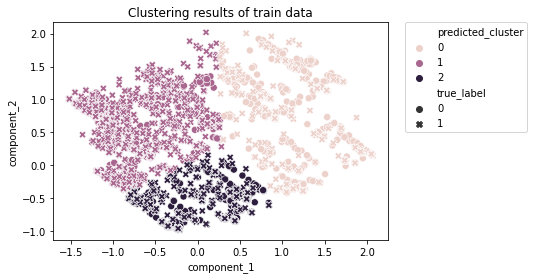

In [56]:
scat = sns.scatterplot("component_1","component_2", s=50, data=pcadf, hue="predicted_cluster", style="true_label")
scat.set_title("Clustering results of train data")
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.0)
plt.show()


/Users/Nicole/Documents/Data_Science/neuefische/projects/Capstone/stroke/Stroke-Outcome/.venv/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


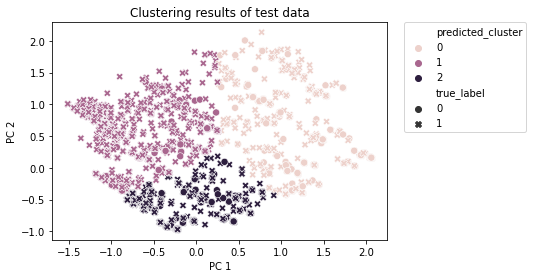

In [57]:
helper.pred_cluster(kmeans_pipe, kmeans_pipe["pca"], kmeans_pipe["kmeans"], X_train_trans_r, X_test_trans, y_test)

#### Plotting with t-SNE 

Here we tried another tool for dimensional reduction: t-Distributed Stochastic Neighbor Embedding (t-SNE). t-SNE converts distances between data in the original space to probabilities.

In [58]:
# Using t-SNE to prepare the data for plotting
X_train_pca = PCA(n_components=3, random_state=42).fit_transform(X_train_trans_r)
Y_tsne = TSNE(n_components = 2, random_state= 42).fit_transform(X_train_pca)

In [60]:
y_train_r.index = range(len(y_train_r))

In [62]:
df_res_kmeans = pd.DataFrame()
df_res_kmeans['TSNE_1'] = Y_tsne[:, 0]
df_res_kmeans['TSNE_2'] = Y_tsne[:, 1]
df_res_kmeans['org_target'] = y_train_r
#df_res_kmeans['true_label'] = y_train
df_res_kmeans['pred_cluster'] = kmeans_pipe["kmeans"].labels_
df_res_kmeans.head()

,TSNE_1,TSNE_2,org_target,pred_cluster
0,-56.252361,52.905788,0,0
1,17.230091,-65.946312,0,0
2,-55.978256,-5.588280,0,2
3,6.965214,5.681775,0,0
4,-37.678745,39.730164,0,2


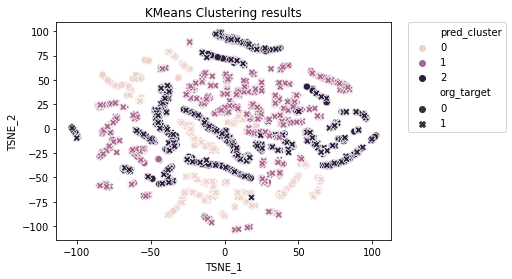

In [63]:
scat = sns.scatterplot(x = 'TSNE_1', y = 'TSNE_2', s=50, data=df_res_kmeans , hue="pred_cluster", style="org_target")
scat.set_title("KMeans Clustering results")
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.0)
plt.show()

We cannot see any distint clusters by changing the dimension reduction tool.

### MiniBatch KMeans

In [41]:
# Define transformer
transformer = ColumnTransformer([
    ("scale", mms, num_cols),
    ("encode", onehot, cat_cols),
])

# Transform
X_train_trans = transformer.fit_transform(X_train)
X_test_trans = transformer.transform(X_test)

# Over/undersampling
X_train_trans_r, y_train_r = sme.fit_resample(X_train_trans, y_train)

In [42]:
# Pipeline for PCA
prepro_pca = PCA(n_components=2, random_state=42)

# Pipeline for clusterer/Kmeans
batchkmeans = MiniBatchKMeans(max_iter=500, n_clusters=2, n_init=50,random_state=42)

batchkmeans_pipe = make_pipeline(prepro_pca, batchkmeans)

batchkmeans_pipe.fit(X_train_trans_r)

Pipeline(steps=[('pca', PCA(n_components=2, random_state=42)),
                ('minibatchkmeans',
                 MiniBatchKMeans(max_iter=500, n_clusters=2, n_init=50,
                                 random_state=42))])

3


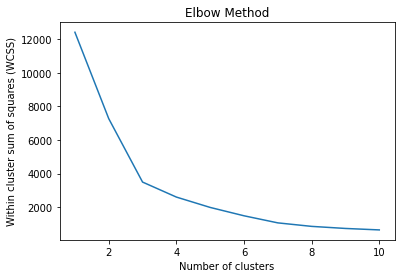

In [43]:
 helper.knee_loc(batchkmeans_pipe, batchkmeans_pipe['minibatchkmeans'], X_train_trans_r)

In [44]:
batchkmeans_pipe['minibatchkmeans'].n_clusters = 3

batchkmeans_pipe.fit(X_train_trans_r)

Pipeline(steps=[('pca', PCA(n_components=2, random_state=42)),
                ('minibatchkmeans',
                 MiniBatchKMeans(max_iter=500, n_clusters=3, n_init=50,
                                 random_state=42))])

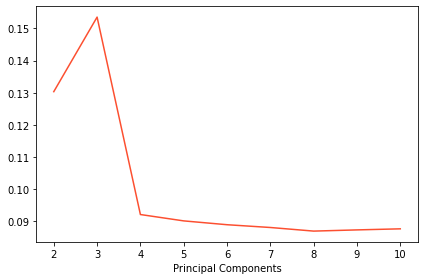

In [45]:
helper.ari_scores(batchkmeans_pipe, batchkmeans_pipe["pca"], batchkmeans_pipe["minibatchkmeans"], X_train_trans_r, y_train_r)

In [46]:
batchkmeans_pipe["pca"].n_components = 3
batchkmeans_pipe.fit(X_train_trans_r)

Pipeline(steps=[('pca', PCA(n_components=3, random_state=42)),
                ('minibatchkmeans',
                 MiniBatchKMeans(max_iter=500, n_clusters=3, n_init=50,
                                 random_state=42))])

In [47]:
ari_batchkmeans = adjusted_rand_score(y_train_r, batchkmeans_pipe["minibatchkmeans"].labels_)
ari_batchkmeans

0.1535190100504534

The ARI is a bit higher than what we got with the KMeans model. However, it is still very low (0.154). Let's have a look at the clusters anyway:

#### Plotting with PCA

/Users/Nicole/Documents/Data_Science/neuefische/projects/Capstone/stroke/Stroke-Outcome/.venv/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


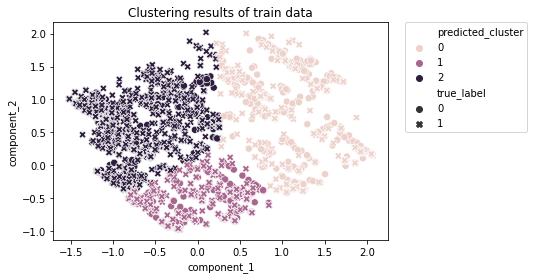

In [95]:
# for plotting only 2 PCs
batchkmeans_pipe["pca"].n_components = 2
batchkmeans_pipe.fit(X_train_trans_r)

pcadf = pd.DataFrame(batchkmeans_pipe['pca'].transform(X_train_trans_r),columns=["component_1", "component_2"],)
pcadf["predicted_cluster"] = batchkmeans_pipe["minibatchkmeans"].labels_
pcadf["true_label"] = y_train_r

scat = sns.scatterplot("component_1","component_2", s=50, data=pcadf, hue="predicted_cluster", style="true_label")
scat.set_title("Clustering results of train data")
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.0)
plt.show()

/Users/Nicole/Documents/Data_Science/neuefische/projects/Capstone/stroke/Stroke-Outcome/.venv/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


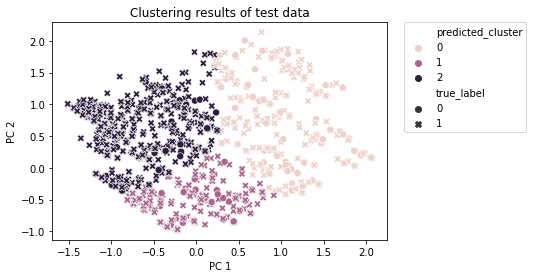

In [96]:
helper.pred_cluster(batchkmeans_pipe, batchkmeans_pipe["pca"], batchkmeans_pipe["minibatchkmeans"], X_train_trans_r, X_test_trans, y_test)

### Agglomerative Clustering

In [48]:
# Define transformer
transformer = ColumnTransformer([
    ("scale", mms, num_cols),
    ("encode", onehot, cat_cols),
])

# Transform
X_train_trans = transformer.fit_transform(X_train)
X_test_trans = transformer.transform(X_test)

# Over/undersampling
X_train_trans_r, y_train_r = sme.fit_resample(X_train_trans, y_train)

In [49]:
# Pipeline for PCA
prepro_pca = PCA(n_components=2, random_state=42)

# Pipeline for Agglomoerative clustering
agg_clust = AgglomerativeClustering(n_clusters=2, linkage='ward')

#
agg_clust_pipe = make_pipeline(prepro_pca, agg_clust)

agg_clust_pipe.fit(X_train_trans_r)

Pipeline(steps=[('pca', PCA(n_components=2, random_state=42)),
                ('agglomerativeclustering', AgglomerativeClustering())])

Calculation of Knee/Elbow does not work here, as AgglomerativeClustering does not have an attribute "interia_".
Trial and Error: we have 2 clusters and check the ARI.

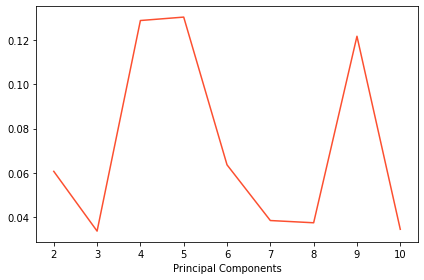

In [50]:
helper.ari_scores(agg_clust_pipe, agg_clust_pipe["pca"], agg_clust_pipe["agglomerativeclustering"], X_train_trans_r, y_train_r)

The ARI is very low again, let's check if this changes when we use 4 clusters.

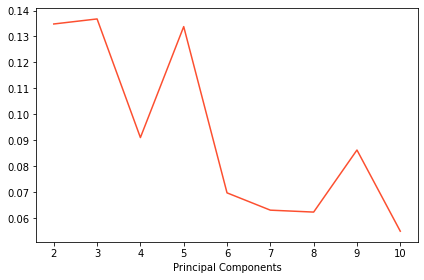

In [51]:
agg_clust_pipe["agglomerativeclustering"].n_clusters = 4
agg_clust_pipe.fit(X_train_trans_r)

helper.ari_scores(agg_clust_pipe, agg_clust_pipe["pca"], agg_clust_pipe["agglomerativeclustering"], X_train_trans_r, y_train_r)

In [52]:
agg_clust_pipe["pca"].n_components= 3
agg_clust_pipe.fit(X_train_trans_r)

Pipeline(steps=[('pca', PCA(n_components=3, random_state=42)),
                ('agglomerativeclustering',
                 AgglomerativeClustering(n_clusters=4))])

In [53]:
ari_agg_clust = adjusted_rand_score(y_train_r, agg_clust_pipe["agglomerativeclustering"].labels_)
ari_agg_clust

0.13676731759320163

The ARI is very low (0.137). We will go ahead and try another algorithm without plotting the results.

### DBSCAN

To find the optimal epsilon for the DBSCAN algorithm, we will compute the following

In [54]:
pca_ = PCA(n_components=4, random_state=42)
X_train_pca = pca_.fit_transform(X_train_trans_r)

(7000.0, 9500.0)

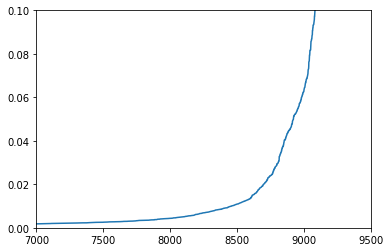

In [55]:
# calculate the distance from each point to its closest neighbors
neigh = NearestNeighbors(n_neighbors=2)
nbrs = neigh.fit(X_train_pca)
# return two arrays containing the closest n_neighbors points and the index for each of these points
distances, indices = nbrs.kneighbors(X_train_pca)

# sort the results and plot
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)
plt.ylim([0, 0.1])
plt.xlim([7000, 9500])

The optimal value for epsilon is at tha point of the maximum curvature. After zooming into the plot we can see that 0.02 might be the best value for epsilon.

In [56]:
db_clust = DBSCAN(eps = 0.01, min_samples = 75).fit(X_train_pca)

In [57]:
ari_db_clust = adjusted_rand_score(y_train_r, db_clust.labels_)
ari_db_clust

0.035329430322552126

After adjusting the minimum of samples in a cluster, the ARI is still very low (0.035). 

## Semi-supervised Learning
### Gaussian Mixture

In [58]:
# Define transformer
transformer = ColumnTransformer([
    ("scale", mms, num_cols),
    ("encode", onehot, cat_cols),
])

# Transform
X_train_trans = transformer.fit_transform(X_train)
X_test_trans = transformer.transform(X_test)

# Over/undersampling
X_train_trans_r, y_train_r = sme.fit_resample(X_train_trans, y_train)

In [71]:
pca_ = PCA(n_components=2, random_state=42)
X_train_pca = pca_.fit_transform(X_train_trans_r)
X_test_pca = pca_.fit_transform(X_test_trans)


We performed model selection with Gaussian Mixture Models using information-theoretic criteria (BIC). Model selection concerns both the covariance type and the number of components in the model. BIC is well suited if the problem is to identify the right model.

In [74]:
lowest_bic = np.infty
bic = []
n_components_range = range(1, 7)
cv_types = ['spherical', 'tied', 'diag', 'full']
for cv_type in cv_types:
    for n_components in n_components_range:
        # Fit a Gaussian mixture with EM
        gmm = GaussianMixture(n_components=n_components,
                                      covariance_type=cv_type)
        gmm.fit(X_train_pca)
        bic.append(gmm.bic(X_train_pca))
        if bic[-1] < lowest_bic:
            lowest_bic = bic[-1]
            best_gmm = gmm

In [75]:
bic = np.array(bic)
color_iter = itertools.cycle(['navy', 'turquoise', 'cornflowerblue','darkorange'])
clf = best_gmm
bars = []

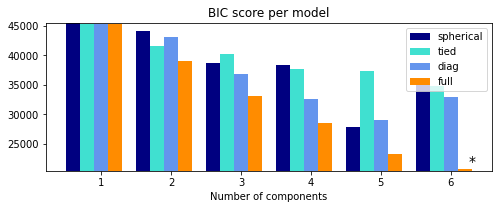

In [76]:
# Plot the BIC scores
plt.figure(figsize=(8, 6))
spl = plt.subplot(2, 1, 1)
for i, (cv_type, color) in enumerate(zip(cv_types, color_iter)):
    xpos = np.array(n_components_range) + .2 * (i - 2)
    bars.append(plt.bar(xpos, bic[i * len(n_components_range):
                                  (i + 1) * len(n_components_range)],
                        width=.2, color=color))
plt.xticks(n_components_range)
plt.ylim([bic.min() * 1.01 - .01 * bic.max(), bic.max()])
plt.title('BIC score per model')
xpos = np.mod(bic.argmin(), len(n_components_range)) + .65 +\
    .2 * np.floor(bic.argmin() / len(n_components_range))
plt.text(xpos, bic.min() * 0.97 + .03 * bic.max(), '*', fontsize=14)
spl.set_xlabel('Number of components')
spl.legend([b[0] for b in bars], cv_types)


The best Gaussian Mixture model will have 6 components with the covariance type "full".

In [77]:
gmm_model = GaussianMixture(n_components=6, covariance_type='full')
gmm_model.fit(X_train_pca)

X_test_pca = pca_.fit_transform(X_test_trans)
y_pred = gmm_model.predict(X_test_pca)

print('adj. rand index: {}'.format(adjusted_rand_score(y_test, y_pred)))

adj. rand index: -0.014525463206505362


With the Gaussian Mixture model the ARI is also very low. 

## Summary

### Supervised Learning

Model | Accuracy | Precision (1) | Recall (1) | Precision (0) | Recall (0)
:--- | ---: | ---: | ---: | ---: | ---: 
Dummy Classifier | 0.50 | 0.81 | 0.5 | 0.19 | 0.50
Logistig Regression (SS) | 0.61 | 0.91 | 0.57 | 0.30 | 0.77
Logistic Regression (MMS) | 0.61 | 0.91 | 0.58 | 0.30 | 0.76
Decision Tree | 0.66 | 0.86 | 0.69 | 0.28 | 0.51
Decision Tree (imbalanced) | 0.69 | 0.82 | 0.79 | 0.28 | 0.28
Decision Tree (imbalanced - grid search) | 0.61 | 0.86 | 0.62 | 0.27 | 0.58
Random Forest | 0.68 | 0.87 | 0.71 | 0.31 | 0.55
**Random Forest (imbalanced)** | 0.76 | 0.82 | 0.89 | 0.29 | 0.19
Random Forest (imbalanced - grid search) | 0.70 | 0.85 | 0.76 | 0.31 | 0.44
Extra Tree | 0.68 | 0.86 | 0.72 | 0.31 | 0.52
XGBoost | 0.65 | 0.87 | 0.66 | 0.30 | 0.59
Support Vector Machine | 0.46 | 0.88 | 0.38 | 0.23 | 0.78

### Unsupervised and semi-supervised Learning
We coould not identify suitable clusters with either of the tested algorithms (KMeans, Minibatch KMeans, Agglomerative Clustering, DBSCAN and Gaussian Mixture). BY implementing the adjusted Rand Index (ARI) we tested how well the models predicted clusters - based on the true clusters (y_train). A good prediction would have yielded in an ARI close to 1. However, our ARI values are very close to 0 (all of them below 0.16) and thus the clusters can also be a result from random assignment of clusters.